# Risk Classifer

## Introduction

BalanceSheet of companies is given as data.

Objective: A business user would like to get insights into the financial health of companies who are EDB’s customers. They are worried about the risk of these companies being unable to complete their projects due to financial reasons and wish to implement more stringent financial checks and controls on riskier companies.


To measure company's fianncial health, several fiancial metrics are considered.

(1) <b>Liquidity</b> : Liquidity is the amount of cash and easily-convertible-to-cash assets a company owns to manage its short-term debt obligations. Before a company can prosper in the long term, it must first be able to survive in the short term.
The two most common metrics used to measure liquidity are the current ratio and the quick ratio.<br>
Quick ratio is present in our dataset. The quick ratio measures a company's capacity to pay its current liabilities without needing to sell its inventory or obtain additional financing.<br>
Quick Ratio = "Quick Assets" / Current Liabilities<br>
where Quick Assets = Cash + Cash Equivalents + Marketable Securities + Net Accounts Receivable<br>
Quick ratio below 1 shows higher risk.<br>

(2) <b>Solvency</b>: a company's ability to meet its debt obligations on an ongoing basis, not just over the short term.
debt-to-equity (D/E) ratio is generally a solid indicator of a company's long-term sustainability.<br>
D/E ratio = Total Liabilites / Total shareholders Equity<br>

(3) <b>Operating Efficiency</b> : Operating margin is one of the best indicators of efficiency. This metric considers a company's basic operational profit margin after deducting the variable costs of producing and marketing the company's products or services

(4) <b>Profitability</b> : Companies can survive for years without being profitable, operating on the goodwill of creditors and investors. But to survive in the long run, a company must eventually attain and maintain profitability.
A good metric for evaluating profitability is net margin, the ratio of net profits to total revenues.

(Source: Investopedia.com)

In [1]:
# Loading the libraries
# Basic Libraries
import numpy as np
from numpy.random import seed
import pandas as pd
# Univariate EDA
from pandas_profiling import ProfileReport
# Data Vsiualization 
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.offline as py
import plotly.graph_objs as go
import plotly.tools as tls
py.init_notebook_mode(connected=True)

import warnings
warnings.filterwarnings('ignore')

# # Modelling
from sklearn.metrics import roc_auc_score, f1_score, precision_recall_curve, confusion_matrix

from sklearn.model_selection import train_test_split,StratifiedKFold,cross_val_score

from catboost import CatBoostClassifier
from xgboost import XGBClassifier

import shap

In [2]:
SEED = 7
np.random.seed(SEED)

In [3]:
pd.set_option('display.float_format', lambda x: '%.6f' % x)
pd.options.display.max_columns = None
pd.options.display.max_rows = None

## Read Data

In [4]:
df = pd.read_excel('Take Home Assignment Data.xlsx')

In [5]:
df.drop(['Unnamed: 0'], axis=1, inplace=True)

## Data Information, Duplicates and Missing values

In [6]:
def show_data_info(data, data_types):
    '''
    Discription: Shows Data Information
    '''
    data.info()
    print("\n")
    for dtype in data_types :
        data_type = data.select_dtypes(include=dtype).dtypes
        if len(data_type) > 0 :
            print(str(len(data_type))+" "+dtype+" Features\n"+str(data_type)+"\n" )

# Display Data Information of "train" :
data_types_list = ["float32","float64","int32","int64","object","category","datetime64[ns]"]

show_data_info(df, data_types_list)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 160 entries, 0 to 159
Data columns (total 30 columns):
 #   Column                                        Non-Null Count  Dtype  
---  ------                                        --------------  -----  
 0   Financial Year                                160 non-null    int64  
 1   Description Of Presentation Currency          160 non-null    object 
 2   Assets                                        160 non-null    float64
 3   Goodwill                                      8 non-null      float64
 4   Intangible Assets Other Than Goodwill         62 non-null     float64
 5   Liabilities                                   160 non-null    float64
 6   Cash And Bank Balances                        154 non-null    float64
 7   Trade And Other Receivables Current           154 non-null    float64
 8   Current Assets                                160 non-null    float64
 9   Current Liabilities                           160 non-null    flo

In [7]:
def show_top_bottom_rows(df, head_rows, tail_rows):
    '''
    Description: Show specified top and bottom rows of dataframe
    '''
    display('Dataframe head and tail: ')
    display(df.head(head_rows).append(df.tail(tail_rows)))
    
show_top_bottom_rows(df, head_rows=3, tail_rows=2)

'Dataframe head and tail: '

,Financial Year,Description Of Presentation Currency,Assets,Goodwill,Intangible Assets Other Than Goodwill,Liabilities,Cash And Bank Balances,Trade And Other Receivables Current,Current Assets,Current Liabilities,Other Current Financial Assets,Other Noncurrent Financial Assets,Other Current Financial Liabilities,Other Noncurrent Financial Liabilities,Cash Flows From Used In Operating Activities,Current Loans And Borrowings,Noncurrent Loans And Borrowings,Profit Loss,Profit Loss Before Taxation,Finance Costs,Revenue,Net Tangible Assets margin,Operating cash flow rati,Debt ratio,NPBT,Unnamed: 25,Quick Ratio,Unnamed: 27,Interest coverage ratio,Risk
0,2019,SGD,0.003707,0.255638,NaN,0.007336,0.002338,0.024389,0.020782,0.014719,NaN,NaN,NaN,NaN,0.471081,0.007778,NaN,0.133511,0.136606,0.084775,0.031574,0.885845,1.497445,0.008646,0.240237,NaN,1.247085,NaN,238.290735,low
1,2019,SGD,0.000445,NaN,NaN,0.001045,0.001389,0.003970,0.002791,0.002026,NaN,NaN,NaN,NaN,0.438466,NaN,NaN,0.112058,0.111797,0.081475,0.001734,0.867937,0.037244,0.000000,0.031510,NaN,1.635299,NaN,5.122706,low
2,2019,SGD,0.001736,NaN,NaN,0.006162,0.000009,0.012100,0.009388,0.012075,NaN,NaN,0.004966,NaN,0.438356,NaN,NaN,0.112056,0.111672,0.079813,0.013339,0.800571,0.000246,0.031045,0.001239,NaN,0.715801,NaN,0.000000,low
158,2019,SGD,0.000689,NaN,NaN,0.001022,0.000876,0.009428,0.005806,0.002317,NaN,NaN,NaN,NaN,0.441063,NaN,NaN,0.113742,0.114150,0.079813,0.001677,0.916706,0.772724,0.000000,0.458568,NaN,2.998544,NaN,0.000000,low
159,2019,USD,0.002046,NaN,0.000268,0.000567,0.001116,0.009383,0.005858,0.001266,NaN,NaN,NaN,NaN,0.439226,NaN,NaN,0.112298,0.112135,0.080764,0.000675,0.985506,0.447498,0.000000,0.233019,NaN,5.429553,NaN,25.758333,low


In [8]:
def remove_duplicate(data):
    '''
    Description: Returns count of duplicate data
    '''
    data = data.drop_duplicates()
    return data.loc[data.duplicated()].shape[0]

number_duplicate_rows = remove_duplicate(df)
df = df.drop_duplicates()


In [9]:
df.shape

(120, 30)

Out of 160 rows, 40 rows were duplicate rows sand hence removed

In [10]:
def missing_value(x):
    '''
    Description: Returns missing value number for each column
    '''
    count_missing = x.isnull().sum()
    percent_missing = x.isnull().sum() * 100 / len(x)
    missing_value_df = pd.DataFrame({'column_name': x.columns,
                                     'count_missing':count_missing,
                                     'percent_missing': percent_missing})
    missing_value_df = missing_value_df[missing_value_df['count_missing']!=0]
    missing_value_df.sort_values(by=['count_missing'],ascending=False, inplace = True)
    return missing_value_df


In [11]:
missing_value(df)

,column_name,count_missing,percent_missing
Unnamed: 25,Unnamed: 25,120,100.000000
Unnamed: 27,Unnamed: 27,120,100.000000
Goodwill,Goodwill,114,95.000000
Other Noncurrent Financial Liabilities,Other Noncurrent Financial Liabilities,113,94.166667
Other Current Financial Assets,Other Current Financial Assets,112,93.333333
Other Noncurrent Financial Assets,Other Noncurrent Financial Assets,110,91.666667
Other Current Financial Liabilities,Other Current Financial Liabilities,83,69.166667
Noncurrent Loans And Borrowings,Noncurrent Loans And Borrowings,82,68.333333
Intangible Assets Other Than Goodwill,Intangible Assets Other Than Goodwill,76,63.333333
Current Loans And Borrowings,Current Loans And Borrowings,70,58.333333


Since this values are related to financial data, it is necessary to find correct imputation technique.
For example, 95% of values of Goodwill column is missing so instead of dropping the column, it is better to impute with 0 as it is possible that other companies were not able to get Goodwill.
Same stetegy has been applied to all the columns

In [12]:
# Dropping Unnamed: 25 and Unnamed: 27 right away

df.drop(['Unnamed: 25', 'Unnamed: 27'], axis=1, inplace=True)

In [13]:
df.shape

(120, 28)

## Univariate EDA

In [14]:
df["Risk_bool"] = np.where(df["Risk"]=="low",0,1)
df.drop(['Risk'], axis=1, inplace=True)

In [15]:
profile = ProfileReport(df)
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

<b>Financial Year</b> has skewed values. 103/120 data is from 2019. And ask is to predict model for 2021. Which is not possible. If company balacesheet is given yearwise then may be forecasting can be done. But in this case, it is safe to neglect the column.

<b>Description Of Presentation Currency</b> has 4 different currencies namely SGD, USD, JPY and EUR. Data is skewed towards SGD. Question can be asked whether we should add FX rates to keep all the numeric data on same scale?

All the numeric values are not in a interpretable scale. May be they are standardized! Also by taking example of few rows, it is difficult to establish equations considering this is a typical balancesheet data. E.G assets are matching liabilities + cash and bank balances


In [16]:
profile.to_file("UnivariateEDA.html")

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

## Bivariate Analysis

Let's see whether numeric column descriptive analytics defers for high risk and low risk!

In [17]:
df.groupby(['Risk_bool']).describe()

Financial Year                                               \
                   count        mean      std         min         25%   
Risk_bool                                                               
0             100.000000 2019.000000 0.000000 2019.000000 2019.000000   
1              20.000000 2017.850000 0.670820 2017.000000 2017.000000   

                                                  Assets                    \
                  50%         75%         max      count     mean      std   
Risk_bool                                                                    
0         2019.000000 2019.000000 2019.000000 100.000000 0.020683 0.107571   
1         2018.000000 2018.000000 2019.000000  20.000000 0.001706 0.002745   

                                                       Goodwill           \
               min      25%      50%      75%      max    count     mean   
Risk_bool                                                                  
0         0.000000 0.000444 0.001319 0.006577 1.000000 5.000000 0.348071   
1         0.000008 0.000103 0.000164 0.002521 0.009187 1.000000 0.000000   

                                                                 \
               std      min      25%      50%      75%      max   
Risk_bool                                                         
0         0.416694 0.000000 0.000000 0.255638 0.484716 1.000000   
1              NaN 0.000000 0.000000 0.000000 0.000000 0.000000   

          Intangible Assets Other Than Goodwill                             \
                                          count     mean      std      min   
Risk_bool                                                                    
0                                     41.000000 0.084873 0.215216 0.000000   
1                                      3.000000 0.000460 0.000518 0.000000   

                                              Liabilities                    \
               25%      50%      75%      max       count     mean      std   
Risk_bool                                                                     
0         0.000114 0.001523 0.037691 1.000000  100.000000 0.025195 0.106593   
1         0.000180 0.000360 0.000690 0.001021   20.000000 0.007222 0.011450   

                                                       Cash And Bank Balances  \
               min      25%      50%      75%      max                  count   
Risk_bool                                                                       
0         0.000000 0.000718 0.002669 0.012304 1.000000              99.000000   
1         0.000062 0.000659 0.001093 0.011115 0.040046              15.000000   

                                                                          \
              mean      std      min      25%      50%      75%      max   
Risk_bool                                                                  
0         0.036859 0.133562 0.000002 0.000468 0.002265 0.010273 1.000000   
1         0.004077 0.006792 0.000000 0.000071 0.000817 0.006918 0.025268   

          Trade And Other Receivables Current                             \
                                        count     mean      std      min   
Risk_bool                                                                  
0                                  100.000000 0.037773 0.113839 0.000000   
1                                   14.000000 0.019016 0.033540 0.000070   

                                              Current Assets           \
               25%      50%      75%      max          count     mean   
Risk_bool                                                               
0         0.001543 0.004884 0.021524 1.000000     100.000000 0.045804   
1         0.001071 0.003485 0.007042 0.098265      20.000000 0.012051   

                                                                 \
               std      min      25%      50%      75%      max   
Risk_bool                                                         
0         0.13

<b>Interest coverage ratio</b> mean has quite wider gap for low risk(505) and high risk(-9)

<b>Quick ratio</b> mean(0.77) is less than 1 for high risk companies

<b>NPBT</b> - Net profit before tax mean is negative for high risk companies

<b>Debt Ratio</b> is quite high for high risk(0.31) compared to low risk(0.12)


In [18]:
X_vars = ['Assets',
       'Goodwill', 'Intangible Assets Other Than Goodwill', 'Liabilities',
       'Cash And Bank Balances', 'Trade And Other Receivables Current',
       'Current Assets', 'Current Liabilities',
       'Other Current Financial Assets', 'Other Noncurrent Financial Assets',
       'Other Current Financial Liabilities',
       'Other Noncurrent Financial Liabilities',
       'Cash Flows From Used In Operating Activities',
       'Current Loans And Borrowings', 'Noncurrent Loans And Borrowings',
       'Profit Loss', 'Profit Loss Before Taxation', 'Finance Costs',
       'Revenue', 'Net Tangible Assets margin', 'Operating cash flow rati',
       'Debt ratio', 'NPBT', 'Quick Ratio', 'Interest coverage ratio']

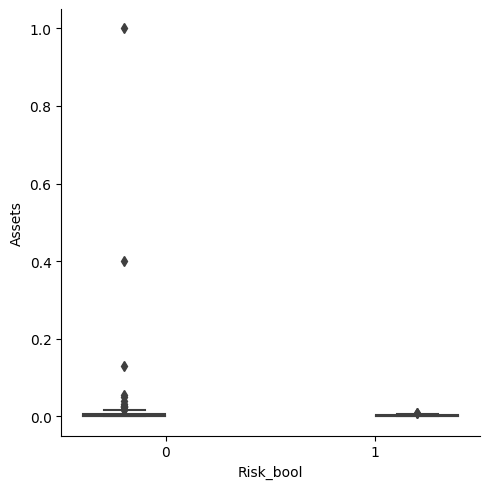

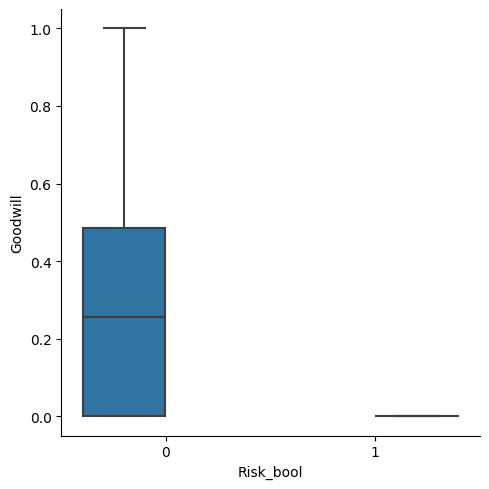

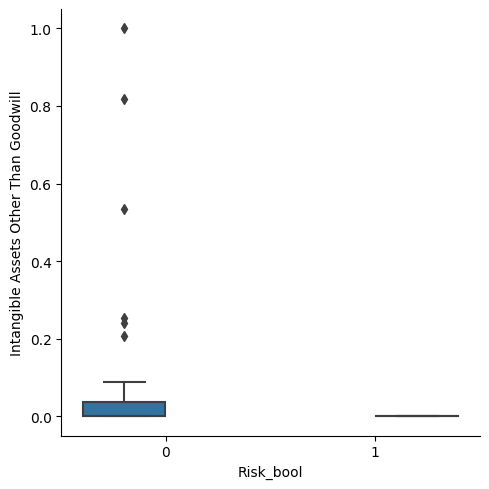

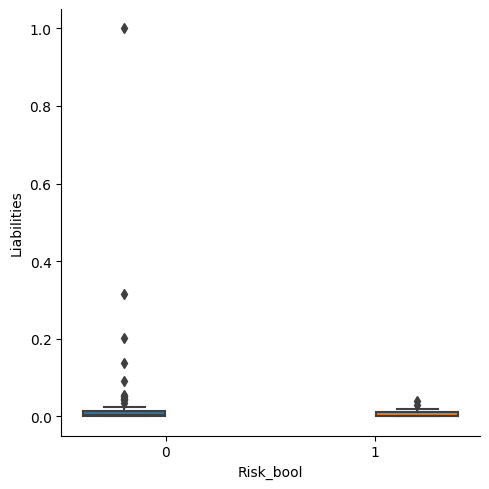

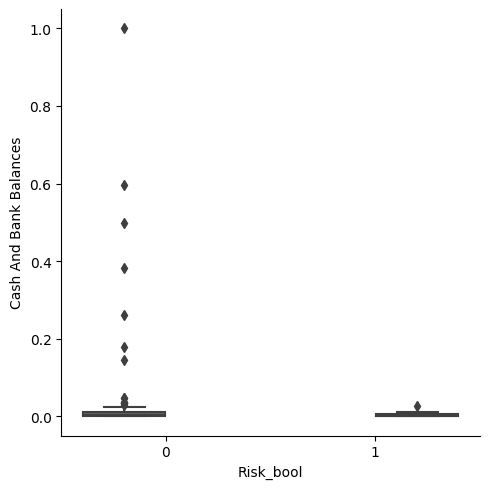

...

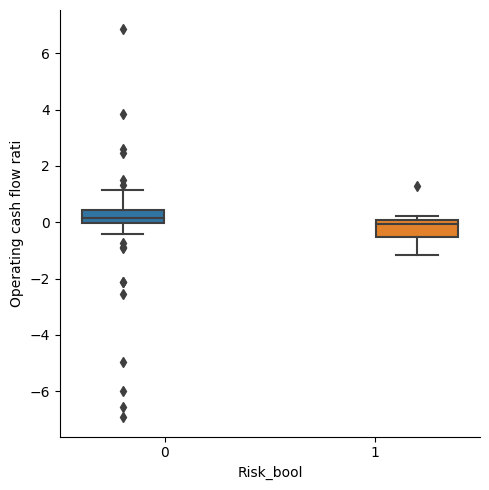

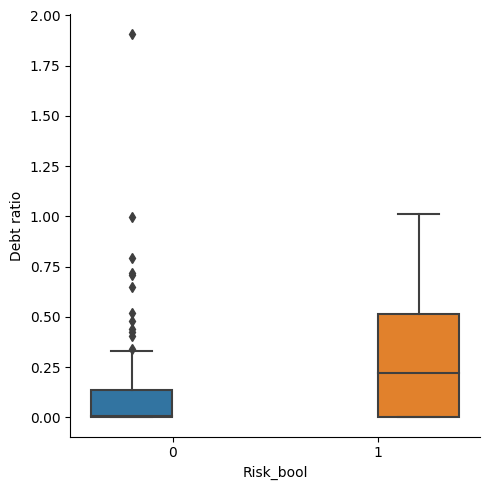

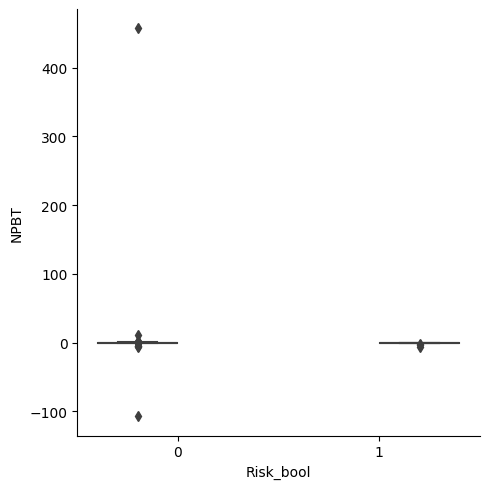

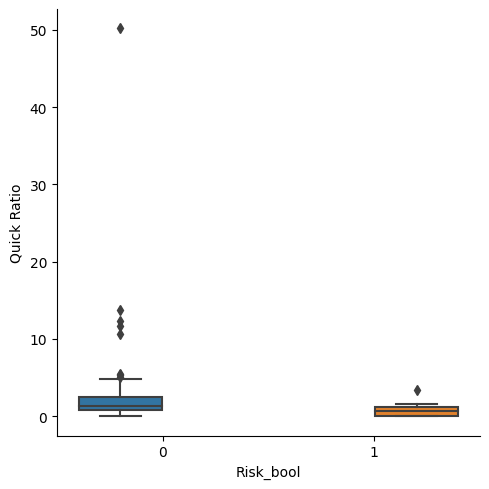

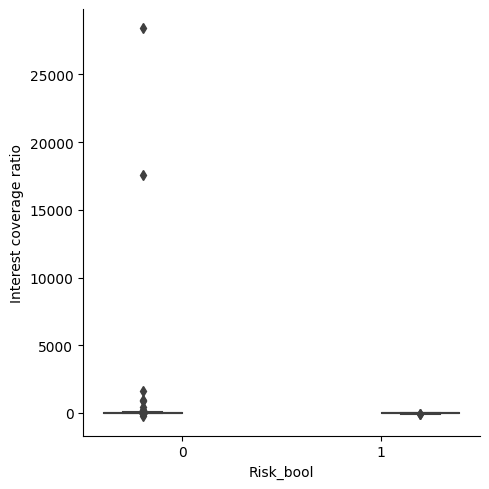

In [19]:
for i in X_vars:
    sns.catplot(data=df, x="Risk_bool", y=i, hue="Risk_bool", kind="box")

## Missing Value Imputation

All the data seeems to be fictitious and scale doesn't match the real values. But since it is financial numbers it is safe to assume that missing values can be no values available and can be replaced with 0.

In [20]:
df = df.fillna(0)

Steps for Feature engineering and outlier detection of data has been skipped due to ficticious nature of data and to keep it to the point.

## Modelling

In [21]:
df.head(2)

,Financial Year,Description Of Presentation Currency,Assets,Goodwill,Intangible Assets Other Than Goodwill,Liabilities,Cash And Bank Balances,Trade And Other Receivables Current,Current Assets,Current Liabilities,Other Current Financial Assets,Other Noncurrent Financial Assets,Other Current Financial Liabilities,Other Noncurrent Financial Liabilities,Cash Flows From Used In Operating Activities,Current Loans And Borrowings,Noncurrent Loans And Borrowings,Profit Loss,Profit Loss Before Taxation,Finance Costs,Revenue,Net Tangible Assets margin,Operating cash flow rati,Debt ratio,NPBT,Quick Ratio,Interest coverage ratio,Risk_bool
0,2019,SGD,0.003707,0.255638,0.000000,0.007336,0.002338,0.024389,0.020782,0.014719,0.000000,0.000000,0.000000,0.000000,0.471081,0.007778,0.000000,0.133511,0.136606,0.084775,0.031574,0.885845,1.497445,0.008646,0.240237,1.247085,238.290735,0
1,2019,SGD,0.000445,0.000000,0.000000,0.001045,0.001389,0.003970,0.002791,0.002026,0.000000,0.000000,0.000000,0.000000,0.438466,0.000000,0.000000,0.112058,0.111797,0.081475,0.001734,0.867937,0.037244,0.000000,0.031510,1.635299,5.122706,0


In [22]:
def data_split(df):
    '''
    Description: Split the dataframe in independent and dependent variable
    '''
    # Normal Split
    X, y = df.iloc[:,:-1], df.iloc[:,-1]
    X_train, X_test, y_train, y_test = train_test_split(df.iloc[:,:-1], df.iloc[:,-1], test_size=0.2, random_state=42)
    return X,y,X_train, X_test, y_train, y_test

X,y,X_train, X_test, y_train, y_test = data_split(df)

In [23]:
X.dtypes

Financial Year                                    int64
Description Of Presentation Currency             object
Assets                                          float64
Goodwill                                        float64
Intangible Assets Other Than Goodwill           float64
Liabilities                                     float64
Cash And Bank Balances                          float64
Trade And Other Receivables Current             float64
Current Assets                                  float64
Current Liabilities                             float64
Other Current Financial Assets                  float64
Other Noncurrent Financial Assets               float64
Other Current Financial Liabilities             float64
Other Noncurrent Financial Liabilities          float64
Cash Flows From Used In Operating Activities    float64
Current Loans And Borrowings                    float64
Noncurrent Loans And Borrowings                 float64
Profit Loss                                     

## Logistic Regression

In [24]:
result_table = pd.DataFrame(columns=['Model','Accuracy','F1','AUC-ROC'])

In [25]:
from sklearn.linear_model import LogisticRegression

In [26]:
X.columns

Index(['Financial Year', 'Description Of Presentation Currency', 'Assets',
       'Goodwill', 'Intangible Assets Other Than Goodwill', 'Liabilities',
       'Cash And Bank Balances', 'Trade And Other Receivables Current',
       'Current Assets', 'Current Liabilities',
       'Other Current Financial Assets', 'Other Noncurrent Financial Assets',
       'Other Current Financial Liabilities',
       'Other Noncurrent Financial Liabilities',
       'Cash Flows From Used In Operating Activities',
       'Current Loans And Borrowings', 'Noncurrent Loans And Borrowings',
       'Profit Loss', 'Profit Loss Before Taxation', 'Finance Costs',
       'Revenue', 'Net Tangible Assets margin', 'Operating cash flow rati',
       'Debt ratio', 'NPBT', 'Quick Ratio', 'Interest coverage ratio'],
      dtype='object')

In [27]:
X.drop(['Financial Year','Description Of Presentation Currency'], axis=1, inplace=True)

In [28]:
clf = LogisticRegression(random_state=0).fit(X, y)

In [29]:
score = clf.score(X, y)  
score

0.8083333333333333

In [30]:
Y_pred = clf.predict(X)  

confusion_matrix(y, Y_pred)

array([[97,  3],
       [20,  0]], dtype=int64)

<AxesSubplot:>

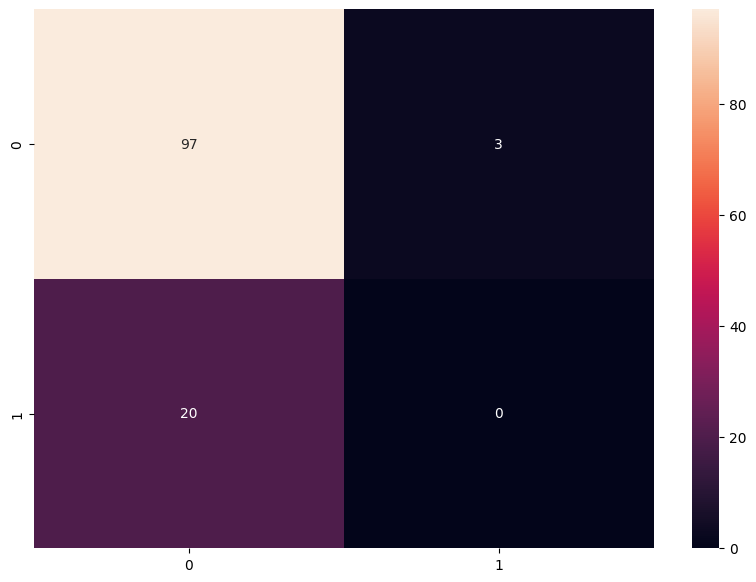

In [31]:
df_cm = pd.DataFrame(confusion_matrix(y, Y_pred), index = [i for i in "01"],
                  columns = [i for i in "01"])
plt.figure(figsize = (10,7))
sns.heatmap(df_cm, annot=True)

Unfortunately this model doesn't identify any high risk company

In [32]:
f1 = f1_score(y, clf.predict(X))
f1

0.0

In [33]:
# calculate precision-recall curve
precision, recall, thresholds = precision_recall_curve(y, Y_pred)
print(precision, recall, thresholds)
# calculate precision-recall AUC
auc_roc = roc_auc_score(y, Y_pred)
print(auc_roc)

[0.16666667 0.         1.        ] [1. 0. 0.] [0 1]
0.485


Though this model has good accuracy, F1 score, AUC_ROC score, it can not be considered good model since it doesn't identify high risk class

Text(0.5, 0, 'Relative Feature Importance')

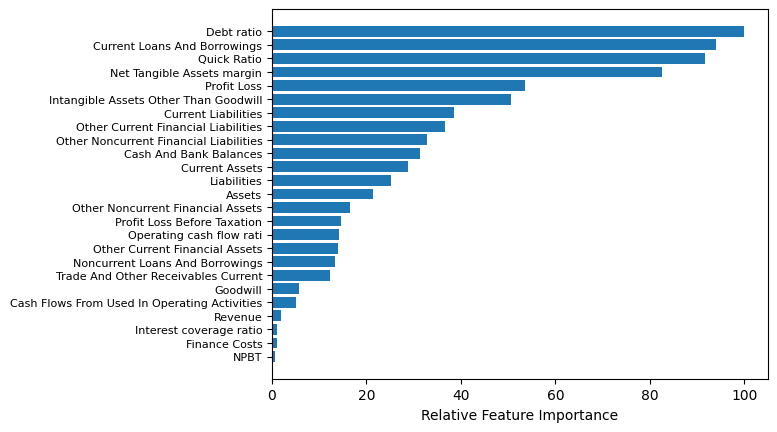

In [34]:
feature_importance = abs(clf.coef_[0])
feature_importance = 100.0 * (feature_importance / feature_importance.max())
sorted_idx = np.argsort(feature_importance)
pos = np.arange(sorted_idx.shape[0]) + .5

featfig = plt.figure()
featax = featfig.add_subplot(1, 1, 1)
featax.barh(pos, feature_importance[sorted_idx], align='center')
featax.set_yticks(pos)
featax.set_yticklabels(np.array(X.columns)[sorted_idx], fontsize=8)
featax.set_xlabel('Relative Feature Importance')

In [35]:
result_dict = {'Model': 'Logistic Regression', 'Accuracy': score, 'F1': f1, 'AUC-ROC':auc_roc}

result_table = result_table.append(result_dict, ignore_index = True)

result_table

,Model,Accuracy,F1,AUC-ROC
0,Logistic Regression,0.808333,0.000000,0.485000


## CatBoost Classification

In [36]:
X,y,X_train, X_test, y_train, y_test = data_split(df)

In [37]:
show_data_info(X, data_types_list)

<class 'pandas.core.frame.DataFrame'>
Int64Index: 120 entries, 0 to 119
Data columns (total 27 columns):
 #   Column                                        Non-Null Count  Dtype  
---  ------                                        --------------  -----  
 0   Financial Year                                120 non-null    int64  
 1   Description Of Presentation Currency          120 non-null    object 
 2   Assets                                        120 non-null    float64
 3   Goodwill                                      120 non-null    float64
 4   Intangible Assets Other Than Goodwill         120 non-null    float64
 5   Liabilities                                   120 non-null    float64
 6   Cash And Bank Balances                        120 non-null    float64
 7   Trade And Other Receivables Current           120 non-null    float64
 8   Current Assets                                120 non-null    float64
 9   Current Liabilities                           120 non-null    flo

In [38]:
cat_features = [1]
number_of_folds = 5

params_cb = {'loss_function':'Logloss', 
          'iterations': 500,
          'eval_metric':'AUC', 
          'verbose': 100,
          'cat_features':cat_features,
#           'class_weights':[0.2372, 0.7628]
         }

In [39]:
# Catboost Model
kf=StratifiedKFold(n_splits=number_of_folds,shuffle=True)
preds_2   = list()
y_pred_2  = []
rocauc_score = []
for i,(train_idx,val_idx) in enumerate(kf.split(X,y)):
    X_train, y_train = X.iloc[train_idx,:], y.iloc[train_idx]
    X_val, y_val = X.iloc[val_idx, :], y.iloc[val_idx]
    print('\nFold: {}\n'.format(i+1))
    cb = CatBoostClassifier(**params_cb)
    cb.fit(X_train, y_train,
           eval_set=[(X_val, y_val)],
           early_stopping_rounds=100,
           use_best_model=True,
           verbose=100,
           plot=True
    )
    roc_auc = roc_auc_score(y_val,cb.predict_proba(X_val)[:, 1])
    rocauc_score.append(roc_auc)
    preds_2.append(cb.predict_proba(df[df.columns])[:, 1])
y_pred_final_2  = np.mean(preds_2,axis=0)



Fold: 1



MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

Learning rate set to 0.024015
0:	test: 1.0000000	best: 1.0000000 (0)	total: 179ms	remaining: 1m 29s
100:	test: 1.0000000	best: 1.0000000 (0)	total: 2.5s	remaining: 9.86s
Stopped by overfitting detector  (100 iterations wait)

bestTest = 1
bestIteration = 0

Shrink model to first 1 iterations.

Fold: 2



MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

Learning rate set to 0.024015
0:	test: 1.0000000	best: 1.0000000 (0)	total: 19.7ms	remaining: 9.82s
100:	test: 1.0000000	best: 1.0000000 (0)	total: 2.24s	remaining: 8.86s
Stopped by overfitting detector  (100 iterations wait)

bestTest = 1
bestIteration = 0

Shrink model to first 1 iterations.

Fold: 3



MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

Learning rate set to 0.024015
0:	test: 0.8062500	best: 0.8062500 (0)	total: 26.6ms	remaining: 13.2s
100:	test: 0.9875000	best: 0.9875000 (19)	total: 2.21s	remaining: 8.74s
Stopped by overfitting detector  (100 iterations wait)

bestTest = 0.9875
bestIteration = 19

Shrink model to first 20 iterations.

Fold: 4



MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

Learning rate set to 0.024015
0:	test: 0.9250000	best: 0.9250000 (0)	total: 20ms	remaining: 9.98s
100:	test: 1.0000000	best: 1.0000000 (9)	total: 2.19s	remaining: 8.64s
Stopped by overfitting detector  (100 iterations wait)

bestTest = 1
bestIteration = 9

Shrink model to first 10 iterations.

Fold: 5



MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

Learning rate set to 0.024015
0:	test: 0.9250000	best: 0.9250000 (0)	total: 23ms	remaining: 11.5s
100:	test: 1.0000000	best: 1.0000000 (10)	total: 2.17s	remaining: 8.57s
Stopped by overfitting detector  (100 iterations wait)

bestTest = 1
bestIteration = 10

Shrink model to first 11 iterations.


In [40]:
print('ROC_AUC - CV Score: {}'.format((sum(rocauc_score)/number_of_folds)),'\n')
print("Score : ",rocauc_score)

ROC_AUC - CV Score: 0.9974999999999999 

Score :  [1.0, 1.0, 0.9874999999999999, 1.0, 1.0]


In [41]:
def plot_feature_importance(importance,names,model_type):
    '''
    Description: Plot feature importance of the model
    '''
    #Create arrays from feature importance and feature names
    feature_importance = np.array(importance)
    feature_names = np.array(names)

    #Create a DataFrame using a Dictionary
    data={'feature_names':feature_names,'feature_importance':feature_importance}
    fi_df = pd.DataFrame(data)

    #Sort the DataFrame in order decreasing feature importance
    fi_df.sort_values(by=['feature_importance'], ascending=False,inplace=True)

    #Define size of bar plot
    plt.figure(figsize=(10,8))
    #Plot Searborn bar chart
    sns.barplot(x=fi_df['feature_importance'], y=fi_df['feature_names'])
    #Add chart labels
    plt.title(model_type + ' FEATURE IMPORTANCE')
    plt.xlabel('FEATURE IMPORTANCE')
    plt.ylabel('FEATURE NAMES')


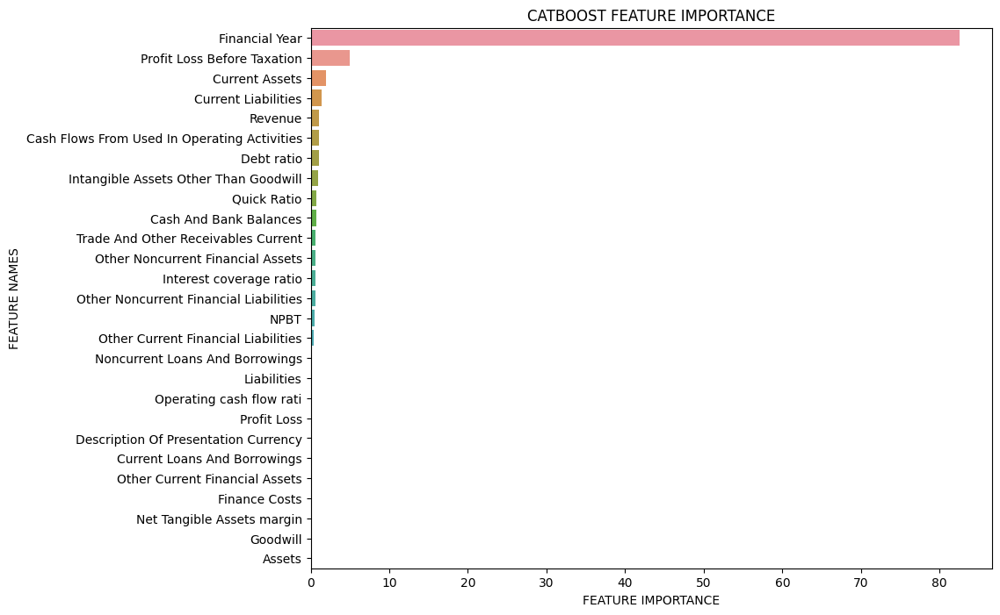

In [42]:
#plot the catboost result
plot_feature_importance(cb.get_feature_importance(),df.columns[:-1],'CATBOOST')

In [43]:
score = cb.score(X, y)  
print('Accuracy',score)

Accuracy 0.975


In [44]:
Y_pred = cb.predict(X)  

from sklearn.metrics import confusion_matrix

confusion_matrix(y, Y_pred)

array([[100,   0],
       [  3,  17]], dtype=int64)

 Skipping financial year as variable

In [45]:
X,y,X_train, X_test, y_train, y_test = data_split(df.iloc[:,1:])

In [46]:
cat_features = [0]
number_of_folds = 5

params_cb = {'loss_function':'Logloss', 
          'iterations': 500,
          'eval_metric':'AUC', 
          'verbose': 100,
          'cat_features':cat_features,
#           'class_weights':[0.2372, 0.7628]
         }

In [47]:
# Catboost Model
kf=StratifiedKFold(n_splits=number_of_folds,shuffle=True)
preds_2   = list()
y_pred_2  = []
rocauc_score = []
for i,(train_idx,val_idx) in enumerate(kf.split(X,y)):
    X_train, y_train = X.iloc[train_idx,:], y.iloc[train_idx]
    X_val, y_val = X.iloc[val_idx, :], y.iloc[val_idx]
    print('\nFold: {}\n'.format(i+1))
    cb = CatBoostClassifier(**params_cb)
    cb.fit(X_train, y_train,
           eval_set=[(X_val, y_val)],
           early_stopping_rounds=100,
           use_best_model=True,
           verbose=100,
           plot=True
    )
    roc_auc = roc_auc_score(y_val,cb.predict_proba(X_val)[:, 1])
    rocauc_score.append(roc_auc)
    preds_2.append(cb.predict_proba(X[X.columns]))
y_pred_final_2  = np.mean(preds_2,axis=0)



Fold: 1



MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

Learning rate set to 0.024015
0:	test: 0.7187500	best: 0.7187500 (0)	total: 21.1ms	remaining: 10.5s
100:	test: 0.8250000	best: 0.8625000 (6)	total: 2.61s	remaining: 10.3s
Stopped by overfitting detector  (100 iterations wait)

bestTest = 0.8625
bestIteration = 6

Shrink model to first 7 iterations.

Fold: 2



MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

Learning rate set to 0.024015
0:	test: 0.8687500	best: 0.8687500 (0)	total: 24.9ms	remaining: 12.4s
100:	test: 0.7875000	best: 0.8687500 (0)	total: 2.41s	remaining: 9.53s
Stopped by overfitting detector  (100 iterations wait)

bestTest = 0.86875
bestIteration = 0

Shrink model to first 1 iterations.

Fold: 3



MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

Learning rate set to 0.024015
0:	test: 0.8500000	best: 0.8500000 (0)	total: 1.95ms	remaining: 974ms
100:	test: 0.9000000	best: 0.9875000 (4)	total: 133ms	remaining: 527ms
Stopped by overfitting detector  (100 iterations wait)

bestTest = 0.9875
bestIteration = 4

Shrink model to first 5 iterations.

Fold: 4



MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

Learning rate set to 0.024015
0:	test: 0.6625000	best: 0.6625000 (0)	total: 26.1ms	remaining: 13s
100:	test: 0.9375000	best: 0.9500000 (11)	total: 2.34s	remaining: 9.24s
Stopped by overfitting detector  (100 iterations wait)

bestTest = 0.95
bestIteration = 11

Shrink model to first 12 iterations.

Fold: 5



MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

Learning rate set to 0.024015
0:	test: 0.7937500	best: 0.7937500 (0)	total: 19.8ms	remaining: 9.89s
100:	test: 0.9000000	best: 0.9750000 (8)	total: 2.4s	remaining: 9.47s
Stopped by overfitting detector  (100 iterations wait)

bestTest = 0.975
bestIteration = 8

Shrink model to first 9 iterations.


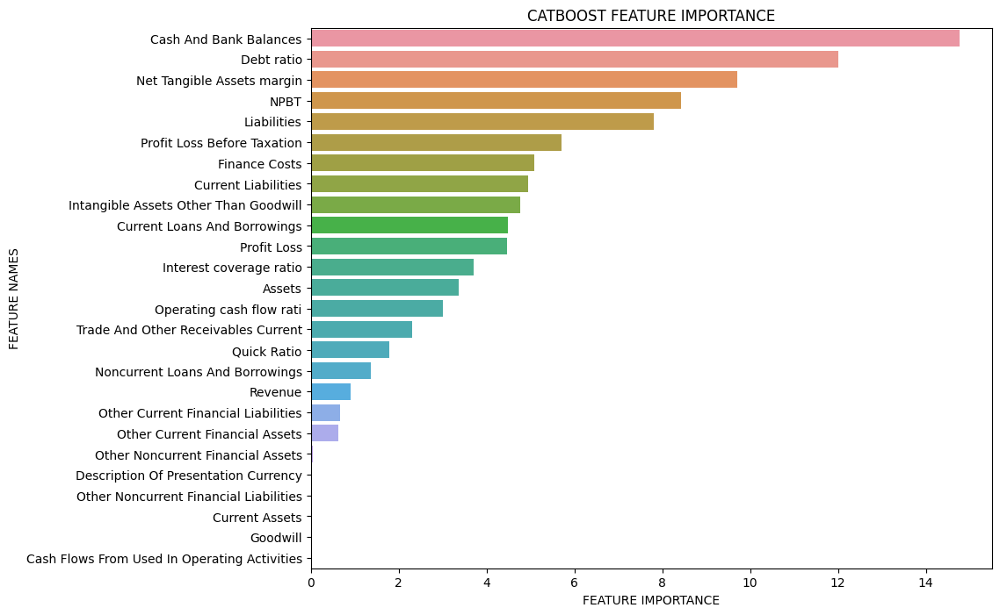

In [48]:
#plot the catboost result
plot_feature_importance(cb.get_feature_importance(),df.columns[1:-1],'CATBOOST')

In [49]:
score = cb.score(X, y)  
score

0.925

In [50]:
f1 = f1_score(y, Y_pred)
f1

0.9189189189189189

In [51]:
# calculate precision-recall curve
precision, recall, thresholds = precision_recall_curve(y, Y_pred)
print(precision, recall, thresholds)
# calculate precision-recall AUC
auc_roc = roc_auc_score(y, Y_pred)
print(auc_roc)

[0.16666667 1.         1.        ] [1.   0.85 0.  ] [0 1]
0.925


In [52]:
Y_pred = cb.predict(X)  

from sklearn.metrics import confusion_matrix

confusion_matrix(y, Y_pred)

array([[100,   0],
       [  9,  11]], dtype=int64)

In [53]:
result_dict = {'Model': 'CatBoost', 'Accuracy': score, 'F1': f1, 'AUC-ROC':auc_roc}

result_table = result_table.append(result_dict, ignore_index = True)

result_table

,Model,Accuracy,F1,AUC-ROC
0,Logistic Regression,0.808333,0.000000,0.485000
1,CatBoost,0.925000,0.918919,0.925000


## XGBoost

In [54]:
df.head(2)

,Financial Year,Description Of Presentation Currency,Assets,Goodwill,Intangible Assets Other Than Goodwill,Liabilities,Cash And Bank Balances,Trade And Other Receivables Current,Current Assets,Current Liabilities,Other Current Financial Assets,Other Noncurrent Financial Assets,Other Current Financial Liabilities,Other Noncurrent Financial Liabilities,Cash Flows From Used In Operating Activities,Current Loans And Borrowings,Noncurrent Loans And Borrowings,Profit Loss,Profit Loss Before Taxation,Finance Costs,Revenue,Net Tangible Assets margin,Operating cash flow rati,Debt ratio,NPBT,Quick Ratio,Interest coverage ratio,Risk_bool
0,2019,SGD,0.003707,0.255638,0.000000,0.007336,0.002338,0.024389,0.020782,0.014719,0.000000,0.000000,0.000000,0.000000,0.471081,0.007778,0.000000,0.133511,0.136606,0.084775,0.031574,0.885845,1.497445,0.008646,0.240237,1.247085,238.290735,0
1,2019,SGD,0.000445,0.000000,0.000000,0.001045,0.001389,0.003970,0.002791,0.002026,0.000000,0.000000,0.000000,0.000000,0.438466,0.000000,0.000000,0.112058,0.111797,0.081475,0.001734,0.867937,0.037244,0.000000,0.031510,1.635299,5.122706,0


In [55]:
X,y,X_train, X_test, y_train, y_test = data_split(df.iloc[:,2:])

In [56]:
number_of_folds = 5

params_xb = {'loss_function':'Logloss', 
          'iterations': 500,
          'eval_metric':'AUC', 
          'verbose': 100,
          'cat_features':cat_features,
#           'class_weights':[0.2372, 0.7628]
         }

In [57]:
# Catboost Model
kf=StratifiedKFold(n_splits=number_of_folds,shuffle=True)
preds_2   = list()
y_pred_2  = []
rocauc_score = []
for i,(train_idx,val_idx) in enumerate(kf.split(X,y)):
    X_train, y_train = X.iloc[train_idx,:], y.iloc[train_idx]
    X_val, y_val = X.iloc[val_idx, :], y.iloc[val_idx]
    print('\nFold: {}\n'.format(i+1))
    xb = XGBClassifier()
    xb.fit(X_train, y_train,
           eval_set=[(X_val, y_val)],
           early_stopping_rounds=100,
           verbose=100
    )
    roc_auc = roc_auc_score(y_val,xb.predict_proba(X_val)[:, 1])
    rocauc_score.append(roc_auc)
    preds_2.append(xb.predict_proba(X[X.columns]))
y_pred_final_2  = np.mean(preds_2,axis=0)



Fold: 1

[0]	validation_0-logloss:0.53874
[99]	validation_0-logloss:0.30763

Fold: 2

[0]	validation_0-logloss:0.55969
[99]	validation_0-logloss:0.45065

Fold: 3

[0]	validation_0-logloss:0.60396
[99]	validation_0-logloss:0.60859

Fold: 4

[0]	validation_0-logloss:0.56272
[99]	validation_0-logloss:0.52119

Fold: 5

[0]	validation_0-logloss:0.52153
[99]	validation_0-logloss:0.41086


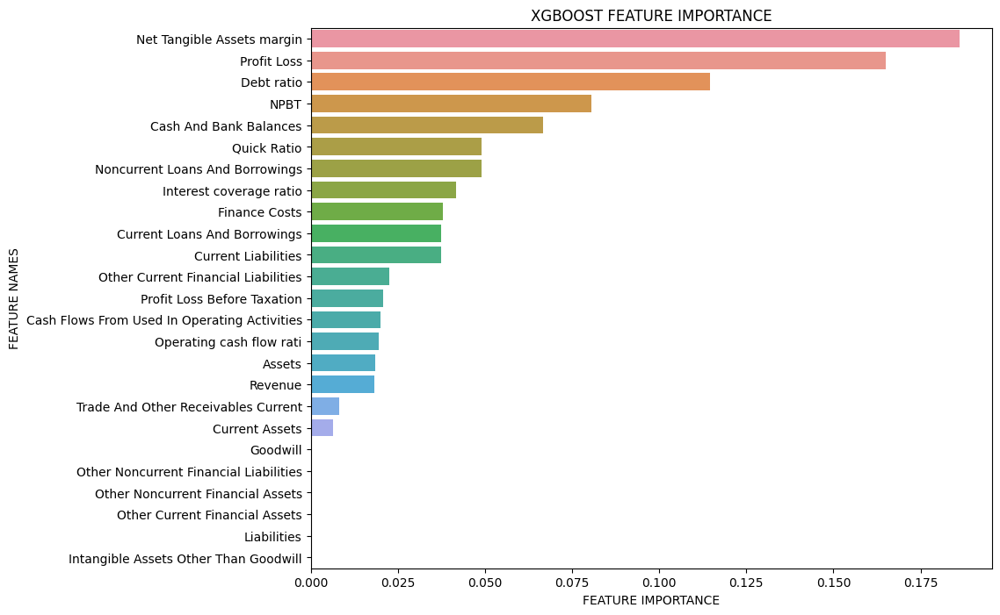

In [58]:
#plot the catboost result
plot_feature_importance(xb.feature_importances_,X.columns,'XGBOOST')

In [59]:
score = xb.score(X, y)  
score

0.975

<AxesSubplot:>

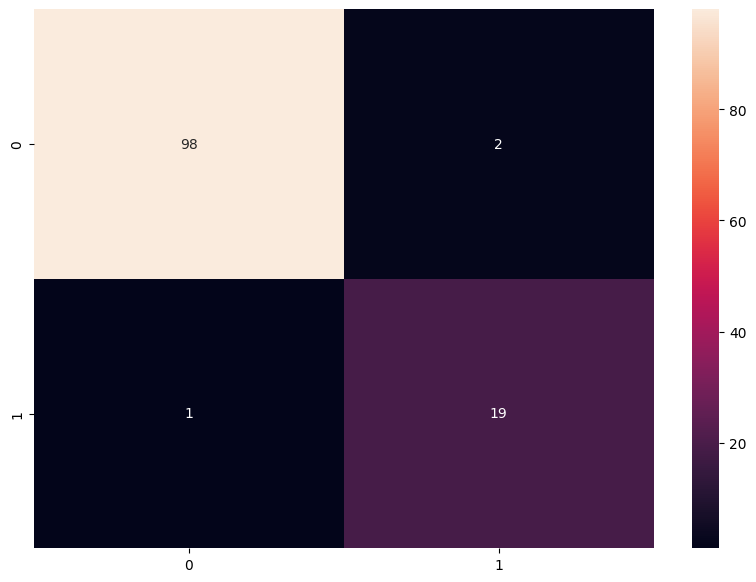

In [60]:
df_cm = pd.DataFrame(confusion_matrix(y, xb.predict(X)), index = [i for i in "01"],
                  columns = [i for i in "01"])
plt.figure(figsize = (10,7))
sns.heatmap(df_cm, annot=True)

In [61]:
f1 = f1_score(y, xb.predict(X))
f1

0.9268292682926829

In [62]:
# calculate precision-recall curve
precision, recall, thresholds = precision_recall_curve(y, xb.predict(X))
print(precision, recall, thresholds)
# calculate precision-recall AUC
auc_roc = roc_auc_score(y, xb.predict(X))
print(auc_roc)

[0.16666667 0.9047619  1.        ] [1.   0.95 0.  ] [0 1]
0.965


In [63]:
result_dict = {'Model': 'XGBoost', 'Accuracy': score, 'F1': f1, 'AUC-ROC':auc_roc}

result_table = result_table.append(result_dict, ignore_index = True)

result_table

,Model,Accuracy,F1,AUC-ROC
0,Logistic Regression,0.808333,0.000000,0.485000
1,CatBoost,0.925000,0.918919,0.925000
2,XGBoost,0.975000,0.926829,0.965000


## Global / Local Feature Importance with shap package

In [64]:
explainer = shap.TreeExplainer(xb)
shap_values = explainer.shap_values(X)
# View shap values
print(shap_values)

[[-0.00625     0.          0.         ... -0.09487955 -0.06546973
  -0.07455382]
 [-0.00625     0.          0.         ... -0.01623323 -0.06546973
  -0.07455382]
 [-0.00625     0.          0.         ...  0.05567911 -0.02916287
   0.04226205]
 ...
 [-0.00625     0.          0.         ...  0.02081101  0.54402524
   0.07346715]
 [ 0.00625     0.          0.         ... -0.01196945 -0.02481458
   0.04226205]
 [ 0.00625     0.          0.         ...  0.08147866 -0.02916287
   0.07558832]]


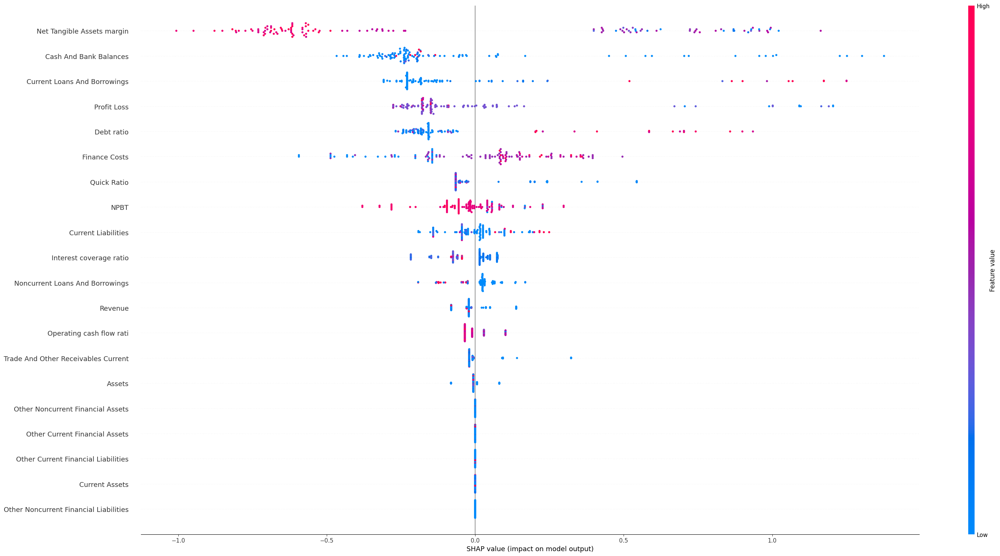

In [65]:
plt_shap = shap.summary_plot(shap_values, #Use Shap values array
                             features=X, # Use training set features
                             feature_names=X.columns, #Use column names
                             show=False, #Set to false to output to folder
                             plot_size=(30,15)) # Change plot size
# Save my figure to a directory
plt.savefig("global_shap.png")

In [66]:
len(shap_values)

120

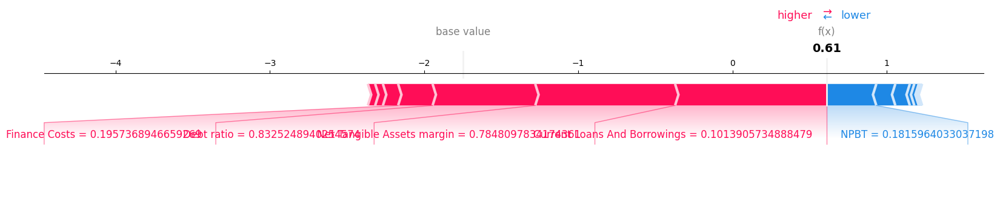

In [67]:
obs_idx = 105 # Relates to a specific patient observation
local_plot = shap.force_plot(explainer.expected_value, 
                             shap_values[obs_idx], 
                 features=X.loc[obs_idx],
                 feature_names=X.columns,
                 show=False, matplotlib=True)
# Save my plot
plt.savefig("force_plot.png")

Raw number 105 is high risk due to High current Loans and Borrowings and low Net Tangible Assets margin and high debt ratio.

## End